[**Demo %s**](#demo-stiffness-explicit)

The `Rodas4P` solver is good for stiff problems, and needs few time steps to solve the Oregonator from {numref}`Demo {number} <demo-stiffness-oregon>`.

In [2]:
using OrdinaryDiffEq
function ode(u,p,t)
    s,w,q = p
    f = [ 
        s * ( u[2]*(1 - u[1]) + u[1]*(1 - q*u[1]) ),
        (u[3] - u[2] - u[1] * u[2]) / s,   
        w * (u[1] - u[3])
        ]
    return f
end
s, w, q = (77.27, .161, 8.375e-6)
oregon = ODEProblem(ode, [1., 2, 3], (0., 25.), [s, w, q])
sol = solve(oregon, Rodas4P())
println("Number of time steps for Rodas4P: $(length(sol.t) - 1)")

Number of time steps for Rodas4P: 127


But if we apply {numref}`Function {number} <function-rk23>` to the problem, the step size will be made small enough to cope with the large negative eigenvalue.

In [3]:
t, u = FNC.rk23(oregon, 1e-4)
println("Number of time steps for RK23: $(length(t) - 1)")

Number of time steps for RK23: 20773


Starting from the eigenvalues of the Jacobian matrix, we can find an effective $\zeta(t)$ by multiplying with the local time step size. The values of $\zeta(t)$ for each time level are plotted below and color coded by component of the diagonalized system.

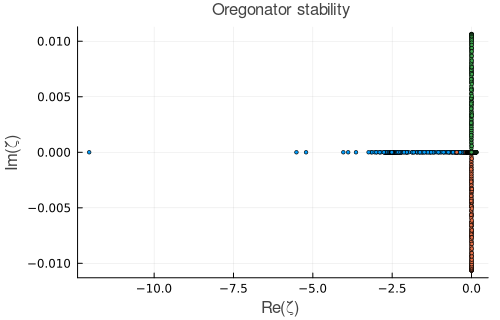

In [4]:
λ = fill(1.0im, length(t),3)
for (k, u) in enumerate(u)
    J = [
    s*(1-u[2]-2q*u[1]) s*(1-u[1])        0 
         -u[2]/s       -(1+u[1])/s     1/s 
            w               0           -w
        ]
    λ[k, :] .= eigvals(J)
end

ζ = diff(t) .* λ[1:end-1,:]
scatter(real(ζ), imag(ζ), m=2,
    xlabel="Re(ζ)",  ylabel="Im(ζ)",
    title="Oregonator stability")

Roughly speaking, the $\zeta$ values stay within or close to the RK2 stability region in {numref}`figure-stabreg_bd_rk`. Momentary departures from the region are possible, but time stepping repeatedly in that situation would cause instability.